In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
#pip install pandas_ta

In [3]:
import pandas_ta as ta

In [4]:
import random
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [5]:
# Everything concerning USDTRY pair is done here, after testing the models CHECK THIS PART!
bist_daily = pd.read_csv("datasets/bist_100_daily.csv")
usdtry_daily = pd.read_csv('datasets/USDTRY_daily.csv')
usdtry_daily = usdtry_daily[["Date","USDTRY_Close"]]
usdtry_daily["Date"]=pd.to_datetime(usdtry_daily["Date"])
bist_daily["Date"] = pd.to_datetime(bist_daily["Date"])
bist_daily = bist_daily.merge(usdtry_daily, how='inner',on="Date")


# Extract the number of rows and columns by using the shape of the data.
numRows,numColumns = bist_daily.shape
# Extract the time interval.
last_date, first_date = bist_daily.iloc[0].Date, bist_daily.iloc[-1].Date
# Check the availability of the data.
na_cols = bist_daily.columns[bist_daily.isna().any()].tolist()

# Print the information.
print(f"There are {numRows} rows and {numColumns} columns in the initial dataset.")
print(f"The data represents the time frame between the dates '{last_date}' and '{first_date}'.")
if not na_cols:
    print("There are no NA rows.")
else:
    print(f"Columns in the dataset which include NA rows: {na_cols}.")
# Convert columns to numeric values
column_names = ["Price", "Open", "High", "Low"]
for column in column_names:
    bist_daily[column] = bist_daily[column].str.replace(',', '')
    bist_daily[column] = pd.to_numeric(bist_daily[column])
# CONVERT TO DATETIME FORMAT AND SORT DATA BY DATE
bist_daily.Date = pd.to_datetime(bist_daily.Date)
bist_daily.sort_values(by="Date", ignore_index=True,inplace=True)
bist_daily.set_index(pd.DatetimeIndex(bist_daily["Date"]), inplace=True)
bist_daily.rename(columns={"Price": "close"},inplace=True)
# Calculate Returns and append to the df DataFrame
# CUMLOGRET_1 and CUMPCTRET_1 are added (NaN values exists)
bist_daily.ta.log_return(cumulative=True, append=True)
bist_daily.ta.percent_return(cumulative=True, append=True)
# Returns a list of indicators and utility functions (to check in future)
ind_list = bist_daily.ta.indicators(as_list=True)
# RSI_14, MACD_12_26_9, MACDh_12_26_9 and MACDs_12_26_9 are added (NaN values exists)
bist_daily.ta.rsi(append=True)
bist_daily.ta.macd(append=True)
# SMA values are added (use ta in the future)
sma_values = [5, 10, 15] 
for i in sma_values:
    bist_daily['SMA'+str(i)] = bist_daily['close'].rolling(window=i).mean()
# Remove all NaN value rows
bist_daily.dropna(inplace=True)
bist_daily

There are 4285 rows and 8 columns in the initial dataset.
The data represents the time frame between the dates '2019-12-02 00:00:00' and '2000-01-05 00:00:00'.
There are no NA rows.


,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38.20M,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60.08M,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53.29M,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33.31M,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44.39M,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1.04B,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970.54M,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1.81B,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


{1: 2938, 2: 308, 3: 775, 4: 125, 5: 64, 6: 15, 7: 10, 10: 3, 11: 3, 12: 2, 28: 1, 29: 2, 31: 4, 60: 1}


<BarContainer object of 14 artists>

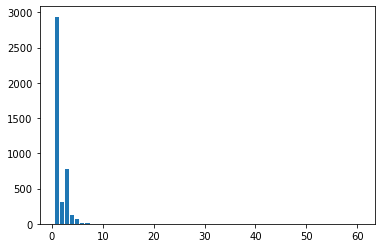

In [6]:
diff = [] 
for date1, date2 in zip(bist_daily["date"][:-1], bist_daily["date"][1:]): 
    diff.append((date2-date1).days) 
unique, counts = np.unique(np.asarray(diff), return_counts=True) 
count_dict = dict(zip(unique, counts)) 
print(count_dict) 
plt.bar(unique,counts)

In [7]:
# edit Vol. column

from operator import itemgetter

vols = bist_daily['Vol.'].to_list()
#[vol[-1] for vol in vols]
#list(filter(lambda vol: "-" in vol,enumerate(vols)))

indexToRemove = bist_daily.iloc[list(map(itemgetter(0),filter(lambda vol: "-" in vol,enumerate(vols))))].index
bist_daily.drop(indexToRemove,inplace=True)
bist_daily['Vol.'] = bist_daily['Vol.'].apply(
    lambda x: float(x[:-1])*(10**6) if x[-1]=="M" else (float(x[:-1])*(10**9) if x[-1]=="B" else "ERROR")).astype("int")
bist_daily

,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38200000,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60080000,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53290000,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33310000,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44390000,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1040000000,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970540000,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1810000000,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


In [8]:
# seeding an arbitrary number to get same results in multiple runs
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Seed:", manualSeed)

Seed: 999


In [9]:
# getting number of GPUs from cuda
ngpu = torch.cuda.device_count()
print("Count of available GPUs:", ngpu)

Count of available GPUs: 1


In [10]:
# printing the name of available GPUs
for i in range(ngpu):
    print("GPU {}: {}".format(i+1, torch.cuda.get_device_name(i)))

GPU 1: GeForce RTX 2060


In [11]:
# batch size for the training
batch_size = 64

# optimizer rates
optimizer_betas = (0.9, 0.999)
learning_rate = 5e-4

# number of epochs
num_epochs = 3000

# evaluate after evaluation_epoch_num epochs
evaluation_epoch_num = 5

# decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [12]:
class TimeseriesDataset(Dataset):
    def __init__(self, data_frame, sequence_length=2):
        self.data = torch.tensor(data_frame.values)
        self.sequence_length = sequence_length

    def __len__(self):
        return self.data.shape[0] - self.sequence_length + 1

    def __getitem__(self, index):
        return self.data[index: index + self.sequence_length].float()
    
    # Non-overlapping series
    # def __getitem__(self, index):
    #     return self.data[index * self.sequence_length: (index+1) * self.sequence_length]

In [13]:
# create pytorch dataset from the pandas DataFrame

# TODO: Convert change(%) and Volume columns to numeric values
columns_used_in_training = ["close", "open", "high", "low", "CUMLOGRET_1", "RSI_14", "MACD_12_26_9", "SMA5"]
# input dimension of the generator
data_dimension = len(columns_used_in_training)
# sequence length of input data
sequence_length = 7

train_data, rest_data = train_test_split(bist_daily[columns_used_in_training], test_size=0.2, shuffle=False)

scaler = MinMaxScaler()
scaler.fit(train_data)
train_data[train_data.columns] = scaler.transform(train_data)
rest_data[rest_data.columns] = scaler.transform(rest_data)

validation_data, test_data = train_test_split(rest_data, test_size=0.5, shuffle=False)

train_dataset = TimeseriesDataset(train_data, sequence_length)
test_dataset = TimeseriesDataset(test_data, sequence_length)
validation_dataset = TimeseriesDataset(validation_data, sequence_length)

# create the dataloader
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
real_data_sample = next(iter(train_dataloader))
print("Real data sample shape:", real_data_sample.shape)

Real data sample shape: torch.Size([64, 7, 8])


In [14]:
class Regressor(nn.Module):
    def __init__(self, hidden_size):
        super(Regressor, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, batch_first=True)
        self.linear = nn.Linear(hidden_size, data_dimension)
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        return res

In [15]:
def model_rmse(model, dataloader, epoch, plot_graph=False, plot_title="Validation Predictions"):
    rmse = 0
    squared_error_list = []
    real_data_list = []
    predicted_data_list = []
    for i, sequence_batch in enumerate(dataloader):
        with torch.no_grad():
            real_sequence = sequence_batch
            # Assign first t values
            regressor_input_sequence = sequence_batch[:,:-1].to(device)
            real_values = sequence_batch[:,-1:]
            #  Generate (t+1)th value from first t values
            predicted_values = regressor(regressor_input_sequence).cpu()
            real_data_list.append(real_values)
            predicted_data_list.append(predicted_values)
    
    real_data = torch.cat(real_data_list, 0)
    predicted_data = torch.cat(predicted_data_list, 0)
    
    # Unscale data
    df_pred = pd.DataFrame(predicted_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_pred_unscaled = pd.DataFrame(scaler.inverse_transform(df_pred),columns=columns_used_in_training)
    df_real = pd.DataFrame(real_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_real_unscaled = pd.DataFrame(scaler.inverse_transform(df_real),columns=columns_used_in_training)
    
    if plot_graph:
        if not os.path.exists('./plots/'):
            os.makedirs('./plots/')
        
        # TODO: get x values and plot prediction of multiple columns
        fig = plt.figure(figsize=(16,8))
        plt.xlabel("Date")
        plt.ylabel("Close Price")
        plt.title(plot_title)
        plt.plot(df_real_unscaled['close'],label="Real")
        plt.plot(df_pred_unscaled['close'],label="Predicted")
        # plt.ylim(bottom=0)
        plt.legend()
        fig.savefig('./plots/plt_epoch_{}.png'.format(epoch))
        plt.close(fig)
        
    squared_errors = (df_real_unscaled['close'] - df_pred_unscaled['close'])**2
    rmse = np.sqrt(squared_errors.mean())
    return rmse

In [16]:
# TODO: weight initialization of models

In [17]:
regressor = Regressor(hidden_size=data_dimension*2).to(device)
print("Regressor is initialized")

Regressor is initialized


In [18]:
criterion = nn.MSELoss()
optimizer_regressor = optim.Adam(regressor.parameters(), lr=learning_rate, betas=optimizer_betas)

In [19]:
if not os.path.exists('./models/'):
    os.makedirs('./models/')

In [22]:
evaluation_metrics = {"regressor_loss":[], "rmse":[]}
                      
print("Training is started")
for epoch in range(num_epochs):
    for i, sequence_batch in enumerate(train_dataloader):
            real_sequence = sequence_batch.to(device)
            # Assign first t values
            regressor_input_sequence = sequence_batch[:,:-1].to(device)
            real_value = sequence_batch[:,-1].to(device)
            #  Generate (t+1)th value from first t values
            predicted_values = regressor(regressor_input_sequence)
            regressor.zero_grad()
            regressor_error = criterion(predicted_values, real_value)
            # Calculate gradients for G
            regressor_error.backward()
            # Update G
            optimizer_regressor.step()
    if (epoch+1) % 5 == 0 or epoch+1 == 1:
        rmse = model_rmse(regressor, validation_dataloader, epoch=(epoch+1), plot_graph=True)
        evaluation_metrics["rmse"].append(rmse)
        evaluation_metrics["regressor_loss"].append(regressor_error.item())
        print('\n[{}/{}]\tRegressor Loss: {:.4f}   \tRMSE:{:.4f}'
                  .format(epoch+1, num_epochs, regressor_error.item(), rmse))
        for col_name, real, generated in zip(columns_used_in_training, sequence_batch[0][-1], predicted_values[0]):
            print(f"{col_name} | Real:{real:.4f} / Generated:{generated:.4f}")
        save_path = os.path.join("./models/","model_epoch_{}.pt".format(epoch+1))
        torch.save({
            'epoch': epoch+1,
            'regressor_model_state_dict': regressor.state_dict(),
            'optimizer_regressor_state_dict': optimizer_regressor.state_dict(),
            'regressor_loss': regressor_error,
            }, save_path)

Training is started

[1/3000]	Regressor Loss: 0.0147   	RMSE:221.0233
close | Real:0.2020 / Generated:0.3146
open | Real:0.2010 / Generated:0.3918
high | Real:0.1998 / Generated:0.2569
low | Real:0.2072 / Generated:0.3284
CUMLOGRET_1 | Real:0.4800 / Generated:0.4276
RSI_14 | Real:0.6529 / Generated:0.5505
MACD_12_26_9 | Real:0.6705 / Generated:0.6529
SMA5 | Real:0.2007 / Generated:0.2229

[5/3000]	Regressor Loss: 0.0065   	RMSE:76.7649
close | Real:0.4558 / Generated:0.5001
open | Real:0.4544 / Generated:0.4946
high | Real:0.4568 / Generated:0.5182
low | Real:0.4643 / Generated:0.5307
CUMLOGRET_1 | Real:0.7280 / Generated:0.7009
RSI_14 | Real:0.5821 / Generated:0.5054
MACD_12_26_9 | Real:0.6453 / Generated:0.6117
SMA5 | Real:0.4577 / Generated:0.5050

[10/3000]	Regressor Loss: 0.0058   	RMSE:67.2174
close | Real:0.5646 / Generated:0.6096
open | Real:0.5687 / Generated:0.5950
high | Real:0.5723 / Generated:0.5824
low | Real:0.5734 / Generated:0.6203
CUMLOGRET_1 | Real:0.7997 / Generated


[115/3000]	Regressor Loss: 0.0029   	RMSE:52.0529
close | Real:0.0627 / Generated:0.0589
open | Real:0.0638 / Generated:0.0479
high | Real:0.0601 / Generated:0.0574
low | Real:0.0658 / Generated:0.0607
CUMLOGRET_1 | Real:0.2187 / Generated:0.2311
RSI_14 | Real:0.6668 / Generated:0.6635
MACD_12_26_9 | Real:0.6985 / Generated:0.7015
SMA5 | Real:0.0582 / Generated:0.0563

[120/3000]	Regressor Loss: 0.0020   	RMSE:55.5000
close | Real:0.0495 / Generated:0.0418
open | Real:0.0524 / Generated:0.0463
high | Real:0.0498 / Generated:0.0399
low | Real:0.0537 / Generated:0.0468
CUMLOGRET_1 | Real:0.1819 / Generated:0.1698
RSI_14 | Real:0.3853 / Generated:0.4223
MACD_12_26_9 | Real:0.5434 / Generated:0.5542
SMA5 | Real:0.0462 / Generated:0.0385

[125/3000]	Regressor Loss: 0.0020   	RMSE:50.7638
close | Real:0.1438 / Generated:0.1340
open | Real:0.1420 / Generated:0.1374
high | Real:0.1413 / Generated:0.1389
low | Real:0.1480 / Generated:0.1394
CUMLOGRET_1 | Real:0.3910 / Generated:0.3577
RSI_14 |


[230/3000]	Regressor Loss: 0.0011   	RMSE:22.2296
close | Real:0.5709 / Generated:0.5871
open | Real:0.5925 / Generated:0.5830
high | Real:0.5903 / Generated:0.5847
low | Real:0.5786 / Generated:0.5873
CUMLOGRET_1 | Real:0.8034 / Generated:0.8097
RSI_14 | Real:0.5835 / Generated:0.6257
MACD_12_26_9 | Real:0.8883 / Generated:0.8330
SMA5 | Real:0.5930 / Generated:0.5946

[235/3000]	Regressor Loss: 0.0014   	RMSE:20.8774
close | Real:0.4339 / Generated:0.4276
open | Real:0.4350 / Generated:0.4265
high | Real:0.4424 / Generated:0.4256
low | Real:0.4420 / Generated:0.4311
CUMLOGRET_1 | Real:0.7119 / Generated:0.7001
RSI_14 | Real:0.7970 / Generated:0.8026
MACD_12_26_9 | Real:0.9269 / Generated:0.8240
SMA5 | Real:0.4377 / Generated:0.4264

[240/3000]	Regressor Loss: 0.0013   	RMSE:21.6514
close | Real:0.7804 / Generated:0.7691
open | Real:0.7798 / Generated:0.7722
high | Real:0.7847 / Generated:0.7704
low | Real:0.7919 / Generated:0.7716
CUMLOGRET_1 | Real:0.9117 / Generated:0.9015
RSI_14 |


[345/3000]	Regressor Loss: 0.0009   	RMSE:16.9263
close | Real:0.3963 / Generated:0.4048
open | Real:0.3967 / Generated:0.4038
high | Real:0.3938 / Generated:0.4042
low | Real:0.3985 / Generated:0.4052
CUMLOGRET_1 | Real:0.6824 / Generated:0.6835
RSI_14 | Real:0.6633 / Generated:0.6818
MACD_12_26_9 | Real:0.6701 / Generated:0.6381
SMA5 | Real:0.3914 / Generated:0.3993

[350/3000]	Regressor Loss: 0.0011   	RMSE:16.8434
close | Real:0.0440 / Generated:0.0283
open | Real:0.0415 / Generated:0.0340
high | Real:0.0404 / Generated:0.0298
low | Real:0.0455 / Generated:0.0348
CUMLOGRET_1 | Real:0.1654 / Generated:0.1442
RSI_14 | Real:0.4932 / Generated:0.4409
MACD_12_26_9 | Real:0.5812 / Generated:0.5931
SMA5 | Real:0.0399 / Generated:0.0247

[355/3000]	Regressor Loss: 0.0010   	RMSE:17.0861
close | Real:0.0674 / Generated:0.0782
open | Real:0.0680 / Generated:0.0788
high | Real:0.0667 / Generated:0.0736
low | Real:0.0716 / Generated:0.0761
CUMLOGRET_1 | Real:0.2312 / Generated:0.2362
RSI_14 |


[460/3000]	Regressor Loss: 0.0007   	RMSE:15.2645
close | Real:0.8734 / Generated:0.8991
open | Real:0.8907 / Generated:0.8993
high | Real:0.8898 / Generated:0.9042
low | Real:0.8878 / Generated:0.9106
CUMLOGRET_1 | Real:0.9516 / Generated:0.9566
RSI_14 | Real:0.5622 / Generated:0.6182
MACD_12_26_9 | Real:0.7446 / Generated:0.7599
SMA5 | Real:0.8931 / Generated:0.9130

[465/3000]	Regressor Loss: 0.0007   	RMSE:16.4177
close | Real:0.6788 / Generated:0.6951
open | Real:0.6801 / Generated:0.6939
high | Real:0.6825 / Generated:0.6975
low | Real:0.6879 / Generated:0.7006
CUMLOGRET_1 | Real:0.8629 / Generated:0.8704
RSI_14 | Real:0.8535 / Generated:0.8681
MACD_12_26_9 | Real:0.8304 / Generated:0.8924
SMA5 | Real:0.6813 / Generated:0.6932

[470/3000]	Regressor Loss: 0.0009   	RMSE:15.3149
close | Real:0.5024 / Generated:0.5176
open | Real:0.5163 / Generated:0.5161
high | Real:0.5128 / Generated:0.5217
low | Real:0.5112 / Generated:0.5240
CUMLOGRET_1 | Real:0.7603 / Generated:0.7714
RSI_14 |


[575/3000]	Regressor Loss: 0.0007   	RMSE:13.9613
close | Real:0.0442 / Generated:0.0479
open | Real:0.0460 / Generated:0.0462
high | Real:0.0437 / Generated:0.0464
low | Real:0.0476 / Generated:0.0499
CUMLOGRET_1 | Real:0.1660 / Generated:0.1758
RSI_14 | Real:0.4703 / Generated:0.4957
MACD_12_26_9 | Real:0.6320 / Generated:0.6258
SMA5 | Real:0.0450 / Generated:0.0499

[580/3000]	Regressor Loss: 0.0008   	RMSE:14.8453
close | Real:0.1972 / Generated:0.1920
open | Real:0.1976 / Generated:0.1937
high | Real:0.1971 / Generated:0.1938
low | Real:0.2014 / Generated:0.1972
CUMLOGRET_1 | Real:0.4733 / Generated:0.4763
RSI_14 | Real:0.3767 / Generated:0.3780
MACD_12_26_9 | Real:0.5798 / Generated:0.5735
SMA5 | Real:0.2040 / Generated:0.2012

[585/3000]	Regressor Loss: 0.0007   	RMSE:14.5824
close | Real:0.4596 / Generated:0.4583
open | Real:0.4525 / Generated:0.4575
high | Real:0.4594 / Generated:0.4593
low | Real:0.4624 / Generated:0.4633
CUMLOGRET_1 | Real:0.7308 / Generated:0.7283
RSI_14 |


[690/3000]	Regressor Loss: 0.0006   	RMSE:13.2033
close | Real:0.5730 / Generated:0.5513
open | Real:0.5562 / Generated:0.5539
high | Real:0.5716 / Generated:0.5541
low | Real:0.5673 / Generated:0.5552
CUMLOGRET_1 | Real:0.8047 / Generated:0.7820
RSI_14 | Real:0.4399 / Generated:0.2876
MACD_12_26_9 | Real:0.6028 / Generated:0.5933
SMA5 | Real:0.5794 / Generated:0.5747

[695/3000]	Regressor Loss: 0.0008   	RMSE:14.1351
close | Real:0.2091 / Generated:0.2080
open | Real:0.2084 / Generated:0.2089
high | Real:0.2065 / Generated:0.2092
low | Real:0.2126 / Generated:0.2131
CUMLOGRET_1 | Real:0.4895 / Generated:0.4809
RSI_14 | Real:0.5609 / Generated:0.6584
MACD_12_26_9 | Real:0.6310 / Generated:0.6426
SMA5 | Real:0.2124 / Generated:0.2043

[700/3000]	Regressor Loss: 0.0006   	RMSE:14.3757
close | Real:0.0665 / Generated:0.0660
open | Real:0.0643 / Generated:0.0685
high | Real:0.0643 / Generated:0.0661
low | Real:0.0671 / Generated:0.0721
CUMLOGRET_1 | Real:0.2287 / Generated:0.2342
RSI_14 |


[805/3000]	Regressor Loss: 0.0005   	RMSE:13.0665
close | Real:0.0291 / Generated:0.0352
open | Real:0.0298 / Generated:0.0347
high | Real:0.0318 / Generated:0.0364
low | Real:0.0319 / Generated:0.0398
CUMLOGRET_1 | Real:0.1167 / Generated:0.1337
RSI_14 | Real:0.3291 / Generated:0.3763
MACD_12_26_9 | Real:0.5820 / Generated:0.5738
SMA5 | Real:0.0313 / Generated:0.0374

[810/3000]	Regressor Loss: 0.0008   	RMSE:14.0440
close | Real:0.0540 / Generated:0.0467
open | Real:0.0547 / Generated:0.0471
high | Real:0.0547 / Generated:0.0456
low | Real:0.0579 / Generated:0.0483
CUMLOGRET_1 | Real:0.1950 / Generated:0.1713
RSI_14 | Real:0.5267 / Generated:0.5276
MACD_12_26_9 | Real:0.5958 / Generated:0.5967
SMA5 | Real:0.0517 / Generated:0.0444

[815/3000]	Regressor Loss: 0.0008   	RMSE:13.3661
close | Real:0.7325 / Generated:0.7202
open | Real:0.7316 / Generated:0.7197
high | Real:0.7352 / Generated:0.7206
low | Real:0.7402 / Generated:0.7264
CUMLOGRET_1 | Real:0.8895 / Generated:0.8896
RSI_14 |


[920/3000]	Regressor Loss: 0.0006   	RMSE:13.4272
close | Real:0.6674 / Generated:0.6604
open | Real:0.6634 / Generated:0.6614
high | Real:0.6650 / Generated:0.6636
low | Real:0.6744 / Generated:0.6649
CUMLOGRET_1 | Real:0.8570 / Generated:0.8450
RSI_14 | Real:0.5208 / Generated:0.4544
MACD_12_26_9 | Real:0.6195 / Generated:0.6066
SMA5 | Real:0.6741 / Generated:0.6748

[925/3000]	Regressor Loss: 0.0005   	RMSE:13.0217
close | Real:0.1524 / Generated:0.1596
open | Real:0.1533 / Generated:0.1629
high | Real:0.1513 / Generated:0.1616
low | Real:0.1574 / Generated:0.1677
CUMLOGRET_1 | Real:0.4056 / Generated:0.4077
RSI_14 | Real:0.5716 / Generated:0.5738
MACD_12_26_9 | Real:0.6607 / Generated:0.6737
SMA5 | Real:0.1519 / Generated:0.1631

[930/3000]	Regressor Loss: 0.0005   	RMSE:13.2378
close | Real:0.7774 / Generated:0.7674
open | Real:0.7725 / Generated:0.7667
high | Real:0.7769 / Generated:0.7713
low | Real:0.7779 / Generated:0.7731
CUMLOGRET_1 | Real:0.9104 / Generated:0.9102
RSI_14 |


[1035/3000]	Regressor Loss: 0.0007   	RMSE:14.0052
close | Real:0.4264 / Generated:0.4258
open | Real:0.4309 / Generated:0.4231
high | Real:0.4279 / Generated:0.4246
low | Real:0.4241 / Generated:0.4260
CUMLOGRET_1 | Real:0.7061 / Generated:0.7074
RSI_14 | Real:0.8570 / Generated:0.8373
MACD_12_26_9 | Real:0.9104 / Generated:0.8891
SMA5 | Real:0.4273 / Generated:0.4212

[1040/3000]	Regressor Loss: 0.0006   	RMSE:12.1680
close | Real:0.1531 / Generated:0.1427
open | Real:0.1551 / Generated:0.1412
high | Real:0.1529 / Generated:0.1426
low | Real:0.1584 / Generated:0.1444
CUMLOGRET_1 | Real:0.4067 / Generated:0.3939
RSI_14 | Real:0.5856 / Generated:0.6015
MACD_12_26_9 | Real:0.6648 / Generated:0.6630
SMA5 | Real:0.1533 / Generated:0.1455

[1045/3000]	Regressor Loss: 0.0007   	RMSE:12.4423
close | Real:0.0311 / Generated:0.0376
open | Real:0.0303 / Generated:0.0374
high | Real:0.0295 / Generated:0.0359
low | Real:0.0347 / Generated:0.0379
CUMLOGRET_1 | Real:0.1236 / Generated:0.1358
RSI_1


[1145/3000]	Regressor Loss: 0.0010   	RMSE:13.2538
close | Real:0.6538 / Generated:0.6482
open | Real:0.6435 / Generated:0.6461
high | Real:0.6508 / Generated:0.6509
low | Real:0.6539 / Generated:0.6523
CUMLOGRET_1 | Real:0.8499 / Generated:0.8497
RSI_14 | Real:0.8002 / Generated:0.7439
MACD_12_26_9 | Real:0.7452 / Generated:0.7393
SMA5 | Real:0.6463 / Generated:0.6473

[1150/3000]	Regressor Loss: 0.0008   	RMSE:12.7283
close | Real:0.7422 / Generated:0.7260
open | Real:0.7330 / Generated:0.7280
high | Real:0.7402 / Generated:0.7319
low | Real:0.7424 / Generated:0.7326
CUMLOGRET_1 | Real:0.8941 / Generated:0.8793
RSI_14 | Real:0.5191 / Generated:0.4011
MACD_12_26_9 | Real:0.6529 / Generated:0.6609
SMA5 | Real:0.7488 / Generated:0.7440

[1155/3000]	Regressor Loss: 0.0008   	RMSE:12.4398
close | Real:0.5052 / Generated:0.4968
open | Real:0.5017 / Generated:0.4988
high | Real:0.5021 / Generated:0.5002
low | Real:0.5052 / Generated:0.5005
CUMLOGRET_1 | Real:0.7622 / Generated:0.7541
RSI_1


[1255/3000]	Regressor Loss: 0.0010   	RMSE:12.4009
close | Real:0.5104 / Generated:0.5064
open | Real:0.5200 / Generated:0.5072
high | Real:0.5185 / Generated:0.5104
low | Real:0.5172 / Generated:0.5126
CUMLOGRET_1 | Real:0.7656 / Generated:0.7598
RSI_14 | Real:0.3367 / Generated:0.3522
MACD_12_26_9 | Real:0.5648 / Generated:0.5685
SMA5 | Real:0.5209 / Generated:0.5185

[1260/3000]	Regressor Loss: 0.0006   	RMSE:13.0766
close | Real:0.4178 / Generated:0.4305
open | Real:0.4320 / Generated:0.4294
high | Real:0.4284 / Generated:0.4321
low | Real:0.4252 / Generated:0.4321
CUMLOGRET_1 | Real:0.6995 / Generated:0.7063
RSI_14 | Real:0.4060 / Generated:0.5018
MACD_12_26_9 | Real:0.5566 / Generated:0.5690
SMA5 | Real:0.4301 / Generated:0.4341

[1265/3000]	Regressor Loss: 0.0005   	RMSE:12.3082
close | Real:0.4229 / Generated:0.4170
open | Real:0.4084 / Generated:0.4133
high | Real:0.4206 / Generated:0.4188
low | Real:0.4070 / Generated:0.4149
CUMLOGRET_1 | Real:0.7035 / Generated:0.6987
RSI_1


[1365/3000]	Regressor Loss: 0.0009   	RMSE:12.1581
close | Real:0.8056 / Generated:0.7901
open | Real:0.7928 / Generated:0.7947
high | Real:0.8028 / Generated:0.7958
low | Real:0.8067 / Generated:0.8011
CUMLOGRET_1 | Real:0.9229 / Generated:0.9132
RSI_14 | Real:0.6920 / Generated:0.6040
MACD_12_26_9 | Real:0.8215 / Generated:0.8155
SMA5 | Real:0.8090 / Generated:0.8069

[1370/3000]	Regressor Loss: 0.0007   	RMSE:12.8595
close | Real:0.7037 / Generated:0.6895
open | Real:0.7026 / Generated:0.6890
high | Real:0.7078 / Generated:0.6921
low | Real:0.7137 / Generated:0.6953
CUMLOGRET_1 | Real:0.8754 / Generated:0.8633
RSI_14 | Real:0.6889 / Generated:0.5951
MACD_12_26_9 | Real:0.7102 / Generated:0.6758
SMA5 | Real:0.6950 / Generated:0.6951

[1375/3000]	Regressor Loss: 0.0005   	RMSE:12.3423
close | Real:0.5145 / Generated:0.5367
open | Real:0.5323 / Generated:0.5342
high | Real:0.5316 / Generated:0.5383
low | Real:0.5229 / Generated:0.5393
CUMLOGRET_1 | Real:0.7683 / Generated:0.7755
RSI_1


[1475/3000]	Regressor Loss: 0.0005   	RMSE:12.4247
close | Real:0.1285 / Generated:0.1390
open | Real:0.1330 / Generated:0.1386
high | Real:0.1293 / Generated:0.1379
low | Real:0.1293 / Generated:0.1396
CUMLOGRET_1 | Real:0.3639 / Generated:0.3826
RSI_14 | Real:0.2950 / Generated:0.4631
MACD_12_26_9 | Real:0.5697 / Generated:0.5826
SMA5 | Real:0.1370 / Generated:0.1405

[1480/3000]	Regressor Loss: 0.0006   	RMSE:12.0660
close | Real:0.1495 / Generated:0.1451
open | Real:0.1449 / Generated:0.1435
high | Real:0.1460 / Generated:0.1418
low | Real:0.1510 / Generated:0.1443
CUMLOGRET_1 | Real:0.4008 / Generated:0.3742
RSI_14 | Real:0.6686 / Generated:0.6015
MACD_12_26_9 | Real:0.6503 / Generated:0.6450
SMA5 | Real:0.1435 / Generated:0.1403

[1485/3000]	Regressor Loss: 0.0008   	RMSE:12.1746
close | Real:0.3063 / Generated:0.3018
open | Real:0.3055 / Generated:0.3048
high | Real:0.3064 / Generated:0.3045
low | Real:0.3080 / Generated:0.3080
CUMLOGRET_1 | Real:0.6014 / Generated:0.5866
RSI_1


[1585/3000]	Regressor Loss: 0.0008   	RMSE:11.9182
close | Real:0.1954 / Generated:0.1832
open | Real:0.1921 / Generated:0.1837
high | Real:0.1936 / Generated:0.1835
low | Real:0.1978 / Generated:0.1860
CUMLOGRET_1 | Real:0.4709 / Generated:0.4470
RSI_14 | Real:0.4404 / Generated:0.3582
MACD_12_26_9 | Real:0.5376 / Generated:0.5309
SMA5 | Real:0.1919 / Generated:0.1858

[1590/3000]	Regressor Loss: 0.0007   	RMSE:11.5181
close | Real:0.7142 / Generated:0.7153
open | Real:0.7039 / Generated:0.7159
high | Real:0.7155 / Generated:0.7204
low | Real:0.7126 / Generated:0.7193
CUMLOGRET_1 | Real:0.8807 / Generated:0.8833
RSI_14 | Real:0.3857 / Generated:0.3752
MACD_12_26_9 | Real:0.2839 / Generated:0.2911
SMA5 | Real:0.7017 / Generated:0.7161

[1595/3000]	Regressor Loss: 0.0007   	RMSE:11.8478
close | Real:0.6594 / Generated:0.6831
open | Real:0.6648 / Generated:0.6838
high | Real:0.6621 / Generated:0.6883
low | Real:0.6403 / Generated:0.6852
CUMLOGRET_1 | Real:0.8529 / Generated:0.8672
RSI_1


[1695/3000]	Regressor Loss: 0.0006   	RMSE:12.8844
close | Real:0.2942 / Generated:0.3124
open | Real:0.2885 / Generated:0.3173
high | Real:0.2910 / Generated:0.3190
low | Real:0.2909 / Generated:0.3178
CUMLOGRET_1 | Real:0.5892 / Generated:0.6008
RSI_14 | Real:0.2561 / Generated:0.2263
MACD_12_26_9 | Real:0.3062 / Generated:0.3131
SMA5 | Real:0.3044 / Generated:0.3262

[1700/3000]	Regressor Loss: 0.0005   	RMSE:12.0105
close | Real:0.5261 / Generated:0.5403
open | Real:0.5402 / Generated:0.5372
high | Real:0.5379 / Generated:0.5426
low | Real:0.5310 / Generated:0.5392
CUMLOGRET_1 | Real:0.7758 / Generated:0.7849
RSI_14 | Real:0.2333 / Generated:0.2798
MACD_12_26_9 | Real:0.2117 / Generated:0.2177
SMA5 | Real:0.5405 / Generated:0.5403

[1705/3000]	Regressor Loss: 0.0007   	RMSE:12.0418
close | Real:0.1590 / Generated:0.1700
open | Real:0.1693 / Generated:0.1718
high | Real:0.1656 / Generated:0.1712
low | Real:0.1645 / Generated:0.1773
CUMLOGRET_1 | Real:0.4162 / Generated:0.4289
RSI_1


[1805/3000]	Regressor Loss: 0.0007   	RMSE:11.9789
close | Real:0.0297 / Generated:0.0376
open | Real:0.0346 / Generated:0.0365
high | Real:0.0312 / Generated:0.0360
low | Real:0.0334 / Generated:0.0394
CUMLOGRET_1 | Real:0.1189 / Generated:0.1547
RSI_14 | Real:0.4528 / Generated:0.5282
MACD_12_26_9 | Real:0.6067 / Generated:0.6110
SMA5 | Real:0.0321 / Generated:0.0336

[1810/3000]	Regressor Loss: 0.0008   	RMSE:12.4309
close | Real:0.2136 / Generated:0.2107
open | Real:0.2198 / Generated:0.2110
high | Real:0.2162 / Generated:0.2114
low | Real:0.2196 / Generated:0.2140
CUMLOGRET_1 | Real:0.4955 / Generated:0.4914
RSI_14 | Real:0.5722 / Generated:0.5315
MACD_12_26_9 | Real:0.6077 / Generated:0.6103
SMA5 | Real:0.2092 / Generated:0.2078

[1815/3000]	Regressor Loss: 0.0009   	RMSE:12.4086
close | Real:0.9508 / Generated:0.9489
open | Real:0.9520 / Generated:0.9527
high | Real:0.9542 / Generated:0.9561
low | Real:0.9572 / Generated:0.9595
CUMLOGRET_1 | Real:0.9819 / Generated:0.9794
RSI_1


[1915/3000]	Regressor Loss: 0.0006   	RMSE:12.9885
close | Real:0.9170 / Generated:0.9162
open | Real:0.9191 / Generated:0.9172
high | Real:0.9190 / Generated:0.9209
low | Real:0.9326 / Generated:0.9231
CUMLOGRET_1 | Real:0.9689 / Generated:0.9717
RSI_14 | Real:0.4323 / Generated:0.4281
MACD_12_26_9 | Real:0.5286 / Generated:0.5359
SMA5 | Real:0.9194 / Generated:0.9277

[1920/3000]	Regressor Loss: 0.0005   	RMSE:11.9986
close | Real:0.0579 / Generated:0.0645
open | Real:0.0595 / Generated:0.0625
high | Real:0.0626 / Generated:0.0622
low | Real:0.0615 / Generated:0.0648
CUMLOGRET_1 | Real:0.2059 / Generated:0.2230
RSI_14 | Real:0.6857 / Generated:0.6945
MACD_12_26_9 | Real:0.7481 / Generated:0.7431
SMA5 | Real:0.0585 / Generated:0.0594

[1925/3000]	Regressor Loss: 0.0006   	RMSE:12.1569
close | Real:0.3718 / Generated:0.3641
open | Real:0.3660 / Generated:0.3654
high | Real:0.3697 / Generated:0.3671
low | Real:0.3748 / Generated:0.3670
CUMLOGRET_1 | Real:0.6620 / Generated:0.6525
RSI_1


[2025/3000]	Regressor Loss: 0.0005   	RMSE:11.7297
close | Real:0.0338 / Generated:0.0345
open | Real:0.0302 / Generated:0.0324
high | Real:0.0302 / Generated:0.0326
low | Real:0.0340 / Generated:0.0350
CUMLOGRET_1 | Real:0.1329 / Generated:0.1412
RSI_14 | Real:0.5205 / Generated:0.4618
MACD_12_26_9 | Real:0.6080 / Generated:0.6049
SMA5 | Real:0.0295 / Generated:0.0301

[2030/3000]	Regressor Loss: 0.0005   	RMSE:12.1512
close | Real:0.0286 / Generated:0.0331
open | Real:0.0316 / Generated:0.0322
high | Real:0.0280 / Generated:0.0314
low | Real:0.0325 / Generated:0.0342
CUMLOGRET_1 | Real:0.1149 / Generated:0.1254
RSI_14 | Real:0.4077 / Generated:0.4963
MACD_12_26_9 | Real:0.5983 / Generated:0.6042
SMA5 | Real:0.0301 / Generated:0.0308

[2035/3000]	Regressor Loss: 0.0007   	RMSE:11.3465
close | Real:0.5490 / Generated:0.5331
open | Real:0.5389 / Generated:0.5316
high | Real:0.5461 / Generated:0.5336
low | Real:0.5461 / Generated:0.5368
CUMLOGRET_1 | Real:0.7902 / Generated:0.7794
RSI_1


[2135/3000]	Regressor Loss: 0.0004   	RMSE:11.8256
close | Real:0.0235 / Generated:0.0255
open | Real:0.0258 / Generated:0.0282
high | Real:0.0248 / Generated:0.0254
low | Real:0.0274 / Generated:0.0298
CUMLOGRET_1 | Real:0.0968 / Generated:0.1111
RSI_14 | Real:0.1993 / Generated:0.2815
MACD_12_26_9 | Real:0.5171 / Generated:0.5180
SMA5 | Real:0.0225 / Generated:0.0216

[2140/3000]	Regressor Loss: 0.0009   	RMSE:12.4602
close | Real:0.8539 / Generated:0.8413
open | Real:0.8460 / Generated:0.8441
high | Real:0.8530 / Generated:0.8450
low | Real:0.8603 / Generated:0.8493
CUMLOGRET_1 | Real:0.9435 / Generated:0.9406
RSI_14 | Real:0.5612 / Generated:0.5300
MACD_12_26_9 | Real:0.5527 / Generated:0.5435
SMA5 | Real:0.8506 / Generated:0.8496

[2145/3000]	Regressor Loss: 0.0005   	RMSE:12.5556
close | Real:0.1850 / Generated:0.1901
open | Real:0.1849 / Generated:0.1899
high | Real:0.1816 / Generated:0.1898
low | Real:0.1881 / Generated:0.1940
CUMLOGRET_1 | Real:0.4561 / Generated:0.4664
RSI_1


[2245/3000]	Regressor Loss: 0.0003   	RMSE:11.7902
close | Real:0.9062 / Generated:0.8963
open | Real:0.8978 / Generated:0.9002
high | Real:0.9085 / Generated:0.9013
low | Real:0.9113 / Generated:0.9073
CUMLOGRET_1 | Real:0.9647 / Generated:0.9606
RSI_14 | Real:0.6026 / Generated:0.5746
MACD_12_26_9 | Real:0.7287 / Generated:0.7312
SMA5 | Real:0.9063 / Generated:0.9087

[2250/3000]	Regressor Loss: 0.0005   	RMSE:12.2566
close | Real:0.5517 / Generated:0.5496
open | Real:0.5613 / Generated:0.5475
high | Real:0.5618 / Generated:0.5513
low | Real:0.5577 / Generated:0.5530
CUMLOGRET_1 | Real:0.7918 / Generated:0.7897
RSI_14 | Real:0.4161 / Generated:0.4148
MACD_12_26_9 | Real:0.4945 / Generated:0.4891
SMA5 | Real:0.5601 / Generated:0.5543

[2255/3000]	Regressor Loss: 0.0007   	RMSE:13.0332
close | Real:0.5649 / Generated:0.5756
open | Real:0.5889 / Generated:0.5735
high | Real:0.5884 / Generated:0.5770
low | Real:0.5748 / Generated:0.5782
CUMLOGRET_1 | Real:0.7998 / Generated:0.8115
RSI_1


[2355/3000]	Regressor Loss: 0.0006   	RMSE:11.5131
close | Real:0.6990 / Generated:0.7130
open | Real:0.7117 / Generated:0.7160
high | Real:0.7098 / Generated:0.7175
low | Real:0.7122 / Generated:0.7216
CUMLOGRET_1 | Real:0.8732 / Generated:0.8813
RSI_14 | Real:0.6262 / Generated:0.7282
MACD_12_26_9 | Real:0.7776 / Generated:0.7953
SMA5 | Real:0.7164 / Generated:0.7239

[2360/3000]	Regressor Loss: 0.0006   	RMSE:12.2652
close | Real:0.3674 / Generated:0.3798
open | Real:0.3671 / Generated:0.3812
high | Real:0.3674 / Generated:0.3823
low | Real:0.3734 / Generated:0.3860
CUMLOGRET_1 | Real:0.6582 / Generated:0.6684
RSI_14 | Real:0.4523 / Generated:0.4847
MACD_12_26_9 | Real:0.6159 / Generated:0.6218
SMA5 | Real:0.3738 / Generated:0.3835

[2365/3000]	Regressor Loss: 0.0005   	RMSE:11.3729
close | Real:0.5364 / Generated:0.5149
open | Real:0.5347 / Generated:0.5115
high | Real:0.5333 / Generated:0.5162
low | Real:0.5388 / Generated:0.5187
CUMLOGRET_1 | Real:0.7823 / Generated:0.7785
RSI_1


[2465/3000]	Regressor Loss: 0.0009   	RMSE:11.5340
close | Real:0.2007 / Generated:0.1891
open | Real:0.1996 / Generated:0.1934
high | Real:0.2002 / Generated:0.1925
low | Real:0.2009 / Generated:0.1945
CUMLOGRET_1 | Real:0.4782 / Generated:0.4554
RSI_14 | Real:0.3748 / Generated:0.2511
MACD_12_26_9 | Real:0.3151 / Generated:0.2875
SMA5 | Real:0.1813 / Generated:0.1905

[2470/3000]	Regressor Loss: 0.0005   	RMSE:11.7756
close | Real:0.0651 / Generated:0.0763
open | Real:0.0720 / Generated:0.0748
high | Real:0.0684 / Generated:0.0740
low | Real:0.0688 / Generated:0.0760
CUMLOGRET_1 | Real:0.2251 / Generated:0.2557
RSI_14 | Real:0.4230 / Generated:0.5095
MACD_12_26_9 | Real:0.6713 / Generated:0.6758
SMA5 | Real:0.0708 / Generated:0.0781

[2475/3000]	Regressor Loss: 0.0006   	RMSE:11.6586
close | Real:0.5759 / Generated:0.5696
open | Real:0.5750 / Generated:0.5703
high | Real:0.5772 / Generated:0.5733
low | Real:0.5852 / Generated:0.5755
CUMLOGRET_1 | Real:0.8064 / Generated:0.8038
RSI_1


[2575/3000]	Regressor Loss: 0.0008   	RMSE:11.7066
close | Real:0.1218 / Generated:0.1172
open | Real:0.1141 / Generated:0.1168
high | Real:0.1184 / Generated:0.1167
low | Real:0.1151 / Generated:0.1190
CUMLOGRET_1 | Real:0.3514 / Generated:0.3400
RSI_14 | Real:0.4259 / Generated:0.3481
MACD_12_26_9 | Real:0.5878 / Generated:0.5811
SMA5 | Real:0.1180 / Generated:0.1178

[2580/3000]	Regressor Loss: 0.0007   	RMSE:11.5541
close | Real:0.3224 / Generated:0.3239
open | Real:0.3171 / Generated:0.3245
high | Real:0.3202 / Generated:0.3256
low | Real:0.3222 / Generated:0.3282
CUMLOGRET_1 | Real:0.6172 / Generated:0.6123
RSI_14 | Real:0.2533 / Generated:0.2491
MACD_12_26_9 | Real:0.3610 / Generated:0.3592
SMA5 | Real:0.3190 / Generated:0.3219

[2585/3000]	Regressor Loss: 0.0005   	RMSE:12.2297
close | Real:0.3579 / Generated:0.3415
open | Real:0.3537 / Generated:0.3436
high | Real:0.3644 / Generated:0.3442
low | Real:0.3615 / Generated:0.3466
CUMLOGRET_1 | Real:0.6499 / Generated:0.6290
RSI_1


[2685/3000]	Regressor Loss: 0.0005   	RMSE:11.9610
close | Real:0.6427 / Generated:0.6436
open | Real:0.6448 / Generated:0.6463
high | Real:0.6451 / Generated:0.6468
low | Real:0.6516 / Generated:0.6520
CUMLOGRET_1 | Real:0.8440 / Generated:0.8439
RSI_14 | Real:0.6258 / Generated:0.6173
MACD_12_26_9 | Real:0.7726 / Generated:0.7833
SMA5 | Real:0.6537 / Generated:0.6512

[2690/3000]	Regressor Loss: 0.0005   	RMSE:12.1044
close | Real:0.0836 / Generated:0.0986
open | Real:0.0908 / Generated:0.0978
high | Real:0.0879 / Generated:0.0976
low | Real:0.0874 / Generated:0.0998
CUMLOGRET_1 | Real:0.2710 / Generated:0.2980
RSI_14 | Real:0.2189 / Generated:0.3269
MACD_12_26_9 | Real:0.5162 / Generated:0.5307
SMA5 | Real:0.0918 / Generated:0.0964

[2695/3000]	Regressor Loss: 0.0008   	RMSE:12.0665
close | Real:0.6999 / Generated:0.6897
open | Real:0.6964 / Generated:0.6917
high | Real:0.6980 / Generated:0.6961
low | Real:0.7058 / Generated:0.6962
CUMLOGRET_1 | Real:0.8736 / Generated:0.8698
RSI_1


[2795/3000]	Regressor Loss: 0.0011   	RMSE:12.2738
close | Real:0.8394 / Generated:0.8424
open | Real:0.8335 / Generated:0.8453
high | Real:0.8385 / Generated:0.8471
low | Real:0.8476 / Generated:0.8499
CUMLOGRET_1 | Real:0.9375 / Generated:0.9301
RSI_14 | Real:0.5630 / Generated:0.5079
MACD_12_26_9 | Real:0.6529 / Generated:0.6395
SMA5 | Real:0.8463 / Generated:0.8564

[2800/3000]	Regressor Loss: 0.0005   	RMSE:11.8169
close | Real:0.0511 / Generated:0.0552
open | Real:0.0483 / Generated:0.0556
high | Real:0.0482 / Generated:0.0538
low | Real:0.0417 / Generated:0.0554
CUMLOGRET_1 | Real:0.1865 / Generated:0.2041
RSI_14 | Real:0.2586 / Generated:0.2223
MACD_12_26_9 | Real:0.5615 / Generated:0.5572
SMA5 | Real:0.0557 / Generated:0.0617

[2805/3000]	Regressor Loss: 0.0008   	RMSE:11.5523
close | Real:0.6839 / Generated:0.6852
open | Real:0.6875 / Generated:0.6872
high | Real:0.6857 / Generated:0.6894
low | Real:0.6946 / Generated:0.6928
CUMLOGRET_1 | Real:0.8655 / Generated:0.8646
RSI_1


[2905/3000]	Regressor Loss: 0.0007   	RMSE:11.7561
close | Real:0.8965 / Generated:0.8670
open | Real:0.8723 / Generated:0.8675
high | Real:0.8939 / Generated:0.8737
low | Real:0.8839 / Generated:0.8753
CUMLOGRET_1 | Real:0.9609 / Generated:0.9501
RSI_14 | Real:0.5641 / Generated:0.4624
MACD_12_26_9 | Real:0.6084 / Generated:0.5772
SMA5 | Real:0.8917 / Generated:0.8847

[2910/3000]	Regressor Loss: 0.0007   	RMSE:11.9862
close | Real:0.3836 / Generated:0.3965
open | Real:0.3975 / Generated:0.3943
high | Real:0.3995 / Generated:0.3970
low | Real:0.3920 / Generated:0.3975
CUMLOGRET_1 | Real:0.6720 / Generated:0.6797
RSI_14 | Real:0.3685 / Generated:0.4278
MACD_12_26_9 | Real:0.4312 / Generated:0.4463
SMA5 | Real:0.3871 / Generated:0.3948

[2915/3000]	Regressor Loss: 0.0004   	RMSE:11.9837
close | Real:0.6791 / Generated:0.6759
open | Real:0.6768 / Generated:0.6756
high | Real:0.6828 / Generated:0.6789
low | Real:0.6894 / Generated:0.6821
CUMLOGRET_1 | Real:0.8631 / Generated:0.8603
RSI_1

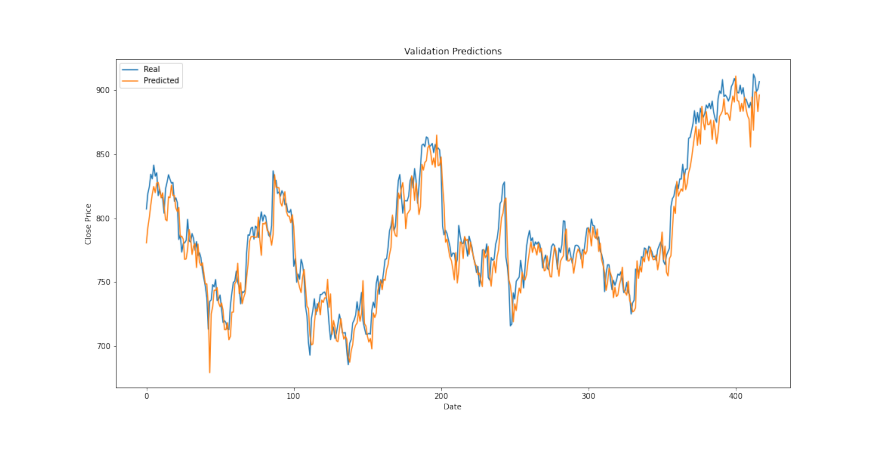

In [23]:
images = []
num_epochs = 995
for epoch in range(num_epochs):
    if (epoch+1)%evaluation_epoch_num == 0 or epoch == 0 or epoch == (num_epochs-1):
        image_path = os.path.join('./plots/', f'plt_epoch_{epoch+1}.png')
        image = plt.imread(image_path)
        images.append(image)
#%%capture
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,8))
plt.axis("off")

all_images = [[plt.imshow(image, animated=True)] for image in images]
plt.rcParams['animation.embed_limit'] = 2**32
ani = animation.ArtistAnimation(fig, all_images, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())